### <span style = 'color:green'> Capstone Project </span>
#### <span style = 'color:blue'> Problem statement : Perform sentiment analysis on Omnicron variant, data fetching directly from twitter</span>
**Sentiment analysis is the process of identifying feelings and emotions expressed in words, through ML or AI**

**Project Pipeline**

Various steps in completing project are

- **Import Necessary Dependencies**
- **Read and Load the Dataset**
- **Exploratory Data Analysis**
- **Data Visualization of Target Variables**
- **Data Preprocessing**
- **Splitting our data into Train and Test Subset**
- **Transforming Dataset using TF-IDF Vectorizer**
- **Function for Model Evaluation**
- **Model Building**
- **Conclusion**

- Here we have to get dataset directly fetched from twitter in realtime 

- performing realtime sentimental analysis on realtime data collecting from twitter
- objective: perform sentiment analysis on realtime data collected from twitter 

                      

           

### <span style = 'color:blue'>   API (Application Programm Interface)</span>
- Imagine you’re sitting at a table in a restaurant with a menu of choices to order from. The kitchen is the part of the “system” that will prepare your order. What is missing is the critical link to communicate your order to the kitchen and deliver your food back to your table. That’s where the waiter or API comes in. The waiter is the messenger – or API – that takes your request or order and tells the kitchen – the system – what to do. Then the waiter delivers the response back to you; in this case, it is the food.
- API's are huge and are used everywhere
- In simple words api stands as bridge for one to access the content in one's storage 
- There are many APIs on the Twitter platform that software developers can engage with, with the ultimate possibility to create fully automated systems which will interact with Twitter. While this feature could benefit companies by drawing insights from Twitter data

   **From twitter api it's possible to extract many insights some are**
- Tweets: searching, posting, filtering, engagement, streaming etc.
- Accounts and users (Beta): account management, user interactions.
- Media: uploading and accessing photos, videos and animated GIFs.
- Trends: trending topics in a given location.
- Geo: information about known places or places near a location.

**Getting twitter API keys**
- If you don't already have an account, you can login with your normal Twitter credentials 


- follow the required prompts to create a developer project or click here <a href="https://dev.twitter.com/apps" title="Twitter">Click here</a>
- Requesting the API key and secret via the Developer Portal causes Twitter to produce the following three things:
1. API key (this is your 'consumer key')
2. API secret key (this is your 'consumer secret')
3. Bearer token
- Next, visit the 'Authentication Tokens' area of the Developer Portal and generate an 'Access token & secret'. This will provide you with the following two items:
1. Access token (this is your 'token key')
2. Access token secret (this is your 'token secret')


**Expected output**
- the data fetched from twitter should undergo EDA for analyzing, cleaning, handling, manupulation, visualization..,etc
- final output should show the sentiment of the data


  *Some tips to consider*

- Machines can learn in every possible way so its always better to think out of the box
    
- Perform eda as diverse as possible and in contineous manner
    
- Try configuring with diffrent models to know how each model is diffrent with other ones 
    
- Donot try to involve unneccesory codes and useless algorithms for dataset which just increases complexity
    
- Approaching problem statement in n number of ways helps us to find best one possible
    
- It's easier for one to understnd and manupulate if we have models as simple as possible 
    
- When we have multiple models we can have multiple judgements based on models and their efficiencies
    
- Tuning helps increasing accuracy :)
    
- Have an idea of time consumed by the model, its better to have a model whose time management is good
    
- Spend good amount of time on analyzing dataset and draw as much insights as possible

- Tweepy is importantlibrary we will using to fetch data from twitter by api


For more on tweepy documentation please click here <a href="https://docs.tweepy.org/en/stable/getting_started.html#hello-tweepy" title="Tweepy">Click here</a>

# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import tweepy
import configparser
import re
from textblob import TextBlob
plt.style.use('fivethirtyeight')
import string
import nltk
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay

# Loading the data

In [2]:

CONSUMER_KEY = 'zae9MScyPCZQ0sfUQcqzchGp7'
CONSUMER_SECRET = 'ISkNIV08zdzWnXyYnm76HVUXMGSi1M5vKnxPQxPZOBwjXHGwpQ'

ACCESS_TOKEN = '1962375516-Jj0hmFsji0xfeQWcCbpE7VjvE5j8l5ueRoaZqVC' 
ACCESS_SECRET = '3ck9LTbEt5VGygZCB8Dz0GpnJdVusr6mcMlnQkAcH0GmN'

In [3]:
auth = tweepy.OAuth1UserHandler(CONSUMER_KEY,CONSUMER_SECRET,)
auth.set_access_token(ACCESS_TOKEN,ACCESS_SECRET)

api = tweepy.API(auth)

In [4]:
keywords = 'Omicron'
limit=1500

tweets = tweepy.Cursor(api.search_tweets, q= keywords,
                       lang='en',count=200, tweet_mode='extended').items(limit)

#store tweets

all_tweets = [tweet.full_text for tweet in tweets]

#show all tweets
all_tweets

['RT @jneill: @ShamezLadhani "#COVID19 has NEVER been a major or significant cause of death in children or adolescents at ANY time during the…',
 'RT @HHSGov: An updated COVID vaccine offers you targeted protection against Omicron. Learn more about updated vaccines.',
 'RT @vvg26: @RageSheen I am not so sure about the description “anti vaxxers”, more like people have deemed it not necessary based on the her…',
 '@desktopcarl @ABridgen 3 vaxxes here and omicron infection and 49 and healthy. Not anti vax but done. Pls stratify that top line of deaths by age and comorbidities. In NY and say the cold trucks filled with bodies - not mininmizing - but 3 years later let’s talk about who’s dying and obesity/lifestyle',
 "RT @RajChaklashiya: @BNOFeed Don't forget that this actually contradicts what the World Health Organization recommends atm (that  COVID-19…",
 '@OnThePisa @Johnincarlisle @YouTube How about his claim that omicron is less virulent ? 🤔 \nhttps://t.co/snpJtHr8zv',
 '@Marc_Veld Fo

In [5]:
#next create a dataframe
df = pd.DataFrame(all_tweets, columns = ['Tweets'])

df.head()

,Tweets
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER..."
1,RT @HHSGov: An updated COVID vaccine offers yo...
2,RT @vvg26: @RageSheen I am not so sure about t...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...


In [6]:
df1 = df.copy()

In [7]:
df1.head()

,Tweets
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER..."
1,RT @HHSGov: An updated COVID vaccine offers yo...
2,RT @vvg26: @RageSheen I am not so sure about t...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...


# Data Preprocessing


### Preprocessing text

In [8]:
#data cleaning
def cleanTwt(twt):
    twt = re.sub('RT','',twt) #remove 'RT' from tweets
    twt = re.sub('#[A-Za-z0-9]+','',twt) #removing hastags from tweets
    twt = re.sub('\\n','',twt) #remove the'\n'
    twt = re.sub('https?\/\/\S+','',twt) #remove hyperlinks from tweets
    twt = re.sub('@[\S]*', '', twt) #remove @mention
    twt = re.sub('^[\S]+|[\s]+$','',twt) #remove leading and trailing whitespaces
    return twt

In [9]:
#create a new coloumn called 'cleaned tweets'
df['cleaned_tweets'] = df['Tweets'].apply(cleanTwt)
#show data
df.head()

,Tweets,cleaned_tweets
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER...",""" has NEVER been a major or significant cau..."
1,RT @HHSGov: An updated COVID vaccine offers yo...,An updated COVID vaccine offers you targeted...
2,RT @vvg26: @RageSheen I am not so sure about t...,I am not so sure about the description “ant...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...,3 vaxxes here and omicron infection and 49 a...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...,Don't forget that this actually contradicts...


In [10]:
#creating a new dataframe
df = pd.DataFrame(df['cleaned_tweets'], columns=['cleaned_tweets'])
#removed any duplicates
df.drop_duplicates(inplace=True)
idx = list(range(0,len(df)))
df = df.set_index(pd.Index(idx))
#show the data
df.tail()

,cleaned_tweets
833,The Wuhan lab leak theory is also wrong by s...
834,on : https://t.co/DwJyO64IXa https://t.co...
835,A year ago we were in the peak of the first ...
836,Kraken (XBB.1.5) now represents 60% of all U...
837,You sure about that? https://t.co/HFqnpBOoY...


In [11]:
def remove_pattern(input_txt, pattern):
    r = re.findall(pattern,input_txt)
    for word in r:
        input_txt = re.sub(word, " ", input_txt)
        return input_txt

In [12]:
#data preprocessing of df1 =
df1.head()
#remove the handle
df1['cleaned_tweet'] = np.vectorize(remove_pattern)(df1['Tweets'], "@[\S]*")

In [13]:
df1.head()

,Tweets,cleaned_tweet
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER...","RT @ShamezLadhani ""#COVID19 has NEVER been a..."
1,RT @HHSGov: An updated COVID vaccine offers yo...,RT An updated COVID vaccine offers you targe...
2,RT @vvg26: @RageSheen I am not so sure about t...,RT @RageSheen I am not so sure about the des...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...,@ABridgen 3 vaxxes here and omicron infectio...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...,RT @BNOFeed Don't forget that this actually ...


In [14]:
df1['cleaned_tweet'] = df1['cleaned_tweet'].str.replace("[^a-zA-Z#]"," ")
df1.head()

,Tweets,cleaned_tweet
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER...",RT ShamezLadhani #COVID has NEVER been a...
1,RT @HHSGov: An updated COVID vaccine offers yo...,RT An updated COVID vaccine offers you targe...
2,RT @vvg26: @RageSheen I am not so sure about t...,RT RageSheen I am not so sure about the des...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...,ABridgen vaxxes here and omicron infectio...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...,RT BNOFeed Don t forget that this actually ...


In [15]:
#remove short words
df1['cleaned_tweet'] = df1['cleaned_tweet'].apply(lambda x: " ".join([w for w in x.split() if len(w)>3]))
df1.head()

,Tweets,cleaned_tweet
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER...",ShamezLadhani #COVID NEVER been major signific...
1,RT @HHSGov: An updated COVID vaccine offers yo...,updated COVID vaccine offers targeted protecti...
2,RT @vvg26: @RageSheen I am not so sure about t...,RageSheen sure about description anti vaxxers ...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...,ABridgen vaxxes here omicron infection healthy...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...,BNOFeed forget that this actually contradicts ...


In [16]:
#individual words consider token
tokenized_tweet = df1['cleaned_tweet'].apply(lambda x: x.split())
tokenized_tweet.head()

0    [ShamezLadhani, #COVID, NEVER, been, major, si...
1    [updated, COVID, vaccine, offers, targeted, pr...
2    [RageSheen, sure, about, description, anti, va...
3    [ABridgen, vaxxes, here, omicron, infection, h...
4    [BNOFeed, forget, that, this, actually, contra...
Name: cleaned_tweet, dtype: object

In [17]:
#steam the words
from nltk.stem.porter import PorterStemmer

Stemmer = PorterStemmer()

tokenized_tweet = tokenized_tweet.apply(lambda x:[Stemmer.stem(word) for word in x])
tokenized_tweet.head()

0    [shamezladhani, #covid, never, been, major, si...
1    [updat, covid, vaccin, offer, target, protect,...
2    [ragesheen, sure, about, descript, anti, vaxxe...
3    [abridgen, vaxx, here, omicron, infect, health...
4    [bnofe, forget, that, thi, actual, contradict,...
Name: cleaned_tweet, dtype: object

In [18]:
#combine the word into single sentence
for i in range(len(tokenized_tweet)):
    tokenized_tweet[i] = " ".join(tokenized_tweet[i])
    
df1['cleaned_tweet'] = tokenized_tweet
df1.head()

,Tweets,cleaned_tweet
0,"RT @jneill: @ShamezLadhani ""#COVID19 has NEVER...",shamezladhani #covid never been major signific...
1,RT @HHSGov: An updated COVID vaccine offers yo...,updat covid vaccin offer target protect agains...
2,RT @vvg26: @RageSheen I am not so sure about t...,ragesheen sure about descript anti vaxxer more...
3,@desktopcarl @ABridgen 3 vaxxes here and omicr...,abridgen vaxx here omicron infect healthi anti...
4,RT @RajChaklashiya: @BNOFeed Don't forget that...,bnofe forget that thi actual contradict what w...


In [70]:
#creating a new dataframe
df1 = pd.DataFrame(df1['cleaned_tweet'], columns=['cleaned_tweet'])
#removed any duplicates
df1.drop_duplicates(inplace=True)
idx = list(range(0,len(df1)))
df1 = df1.set_index(pd.Index(idx))
#show the data
df1.tail()

,cleaned_tweet
638,jfgariepi plagiar social media drama frozen ti...
639,bretweinstein wuhan leak theori also wrong sev...
640,year were peak first omicron wave mani hope th...
641,kraken repres #covid case averag death month j...
642,fnkycoldmoderna ericareport sure about that ht...


# Exploratory Data Analysis

## Check sentiment of tweets

### Create WordCloud

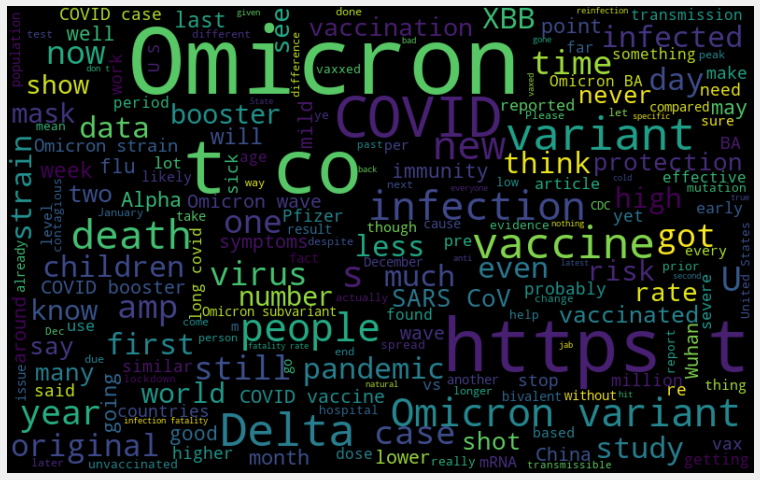

In [19]:
#visualize frequent words
all_words = " ".join([sentence for sentence in df['cleaned_tweets']])

from wordcloud import WordCloud
wordcloud = WordCloud(width=800, height=500, random_state=42, max_font_size=100).generate(all_words)

#plot graphs
plt.figure(figsize=(15,8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

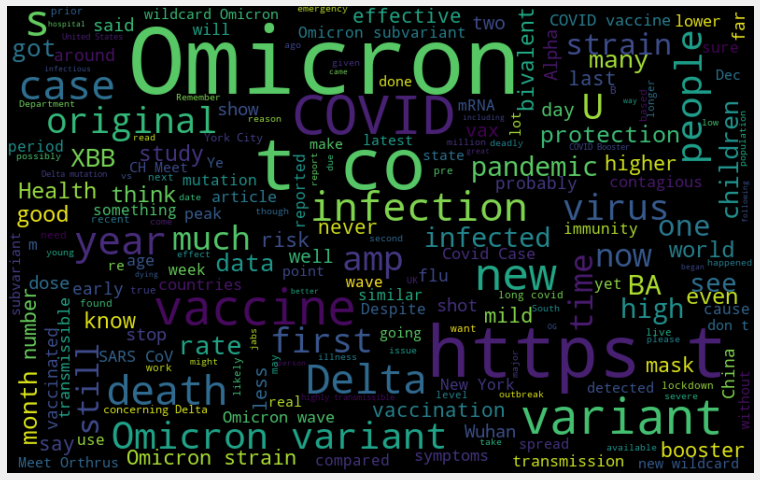

In [28]:
#visualize frequent words +ve
all_words = " ".join([sentence for sentence in df['cleaned_tweets'][df['Polarity']>0]])

from wordcloud import WordCloud
wordcloud = WordCloud(width=800, height=500, random_state=42, max_font_size=100).generate(all_words)

#plot graphs
plt.figure(figsize=(15,8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [29]:
#extract hastag
def hashtag_extract(tweets):
    hashtags = []
    #loops words in tweets
    for tweet in tweets:
        ht = re.findall(r"#(\w+)", tweet)
        hashtags.append(ht)
    return hashtags    
        
        

<AxesSubplot:>

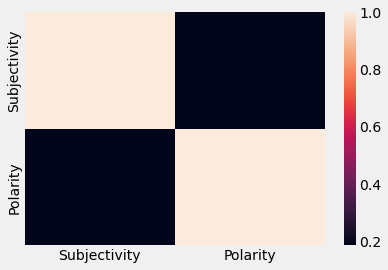

In [30]:
sns.heatmap(df.corr())

In [75]:
vect = CountVectorizer(ngram_range=(1,2)).fit(df1['cleaned_tweet'])

In [76]:
feature_names = vect.get_feature_names()
print('number of features: {}\n'.format(len(feature_names)))
print('first 20 features:\n {}'.format(feature_names[:20]))

number of features: 11693

first 20 features:
 ['abat', 'abcsydney', 'abcsydney clubsnsw', 'abil', 'abil infect', 'abl', 'abl count', 'abl emul', 'abl function', 'abl quickli', 'abl send', 'aboubinboobi', 'aboubinboobi tfrcom', 'about', 'about been', 'about billion', 'about chicago', 'about claim', 'about descript', 'about die']


# Input split

In [111]:
X = df['cleaned_tweets']
Y = df['Sentiment']
X = vect.transform(X)

In [113]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, random_state=42, test_size=0.2)

In [114]:
print('size of x_train:', (X_train.shape))
print('size of x_test:', (X_test.shape))
print('size of y_train:', (Y_train.shape))
print('size of y_test:', (Y_test.shape))

size of x_train: (670, 11693)
size of x_test: (168, 11693)
size of y_train: (670,)
size of y_test: (168,)


# Model Training

### Logistic regression

In [40]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score

In [115]:
logreg = LogisticRegression()
logreg.fit(X_train, Y_train)
logreg_pred = logreg.predict(X_test)
logreg_acc = accuracy_score(logreg_pred, Y_test)
print('test accuracy: {:.2f}%'.format(logreg_acc*100))

test accuracy: 63.69%


In [116]:
print(confusion_matrix(Y_test, logreg_pred))
print("\n")
print(classification_report(Y_test, logreg_pred))

[[15  6 18]
 [ 4 26  9]
 [12 12 66]]


              precision    recall  f1-score   support

    Negative       0.48      0.38      0.43        39
     Neutral       0.59      0.67      0.63        39
    Positive       0.71      0.73      0.72        90

    accuracy                           0.64       168
   macro avg       0.59      0.59      0.59       168
weighted avg       0.63      0.64      0.63       168



#### got accuracy of 64% :\

In [117]:
from matplotlib import style
style.use('ggplot')

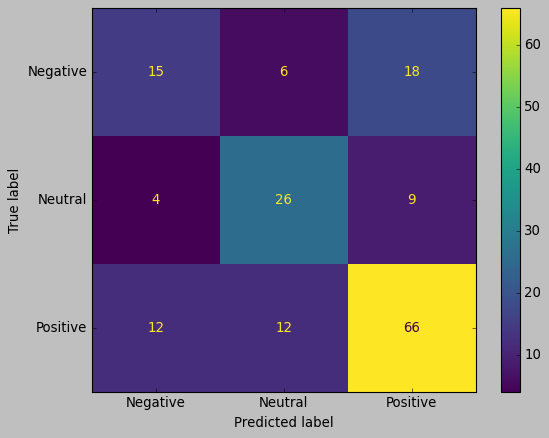

In [118]:
style.use('classic')
cm = confusion_matrix(Y_test, logreg_pred, labels=logreg.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=logreg.classes_)
disp.plot()

## Hyperparameter tunning 

### Logistic regression tunned

In [88]:
#improving the model performance
from sklearn.model_selection import GridSearchCV

In [119]:
param_grid={'C':[0.001, 0.01, 0.1, 1, 10]}
grid = GridSearchCV(LogisticRegression(), param_grid)
grid.fit(X_train, Y_train)

GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10]})

In [120]:
print('best parameters:', grid.best_params_)

best parameters: {'C': 1}


In [121]:
Y_pred = grid.predict(X_test)

In [122]:
logreg_acc = accuracy_score(Y_pred, Y_test)
print('test accuracy: {:.2f}%'.format(logreg_acc*100))

test accuracy: 63.69%


#### after tunning 1% of my test accuracy reduced!! #omo

In [123]:
#lets print confusion matrix after tunning
print(confusion_matrix(Y_test, Y_pred))
print("\n")
print(classification_report(Y_test, Y_pred))

[[15  6 18]
 [ 4 26  9]
 [12 12 66]]


              precision    recall  f1-score   support

    Negative       0.48      0.38      0.43        39
     Neutral       0.59      0.67      0.63        39
    Positive       0.71      0.73      0.72        90

    accuracy                           0.64       168
   macro avg       0.59      0.59      0.59       168
weighted avg       0.63      0.64      0.63       168



## SVC Model

In [94]:
from sklearn.svm import LinearSVC

In [124]:
SVmodel = LinearSVC()
SVmodel.fit(X_train, Y_train)

LinearSVC()

In [125]:
svc_pred = SVmodel.predict(X_test)
svc_acc = accuracy_score(svc_pred, Y_test)
print("test accuracy : {:.2f}%".format(svc_acc*100))

test accuracy : 65.48%


In [126]:
print(confusion_matrix(Y_test, svc_pred))
print("\n")
print(classification_report(Y_test, svc_pred))

[[18  8 13]
 [ 4 27  8]
 [12 13 65]]


              precision    recall  f1-score   support

    Negative       0.53      0.46      0.49        39
     Neutral       0.56      0.69      0.62        39
    Positive       0.76      0.72      0.74        90

    accuracy                           0.65       168
   macro avg       0.62      0.63      0.62       168
weighted avg       0.66      0.65      0.65       168



#### got accuracy of 65%!!

## SVC Tunned

In [127]:
grid = {
    'C':[0.01, 0.1, 1, 10],
     "kernel":['linear','poly','rbf','sigmoid'],
     'degree':[1,3,5,7],
     'gamma':[0.01,1]
}
grid = GridSearchCV(SVmodel, param_grid)
grid.fit(X_train, Y_train)

GridSearchCV(estimator=LinearSVC(), param_grid={'C': [0.001, 0.01, 0.1, 1, 10]})

In [128]:
print('best parameter:', grid.best_params_)

best parameter: {'C': 0.1}


In [129]:
Y_pred = grid.predict(X_test)

In [130]:
logreg_acc = accuracy_score(Y_pred, Y_test)
print('test accuracy: {:.2f}%'.format(logreg_acc*100))

test accuracy: 62.50%


In [131]:
print(confusion_matrix(Y_test, Y_pred))
print("\n")
print(classification_report(Y_test, Y_pred))

[[13  6 20]
 [ 5 26  8]
 [11 13 66]]


              precision    recall  f1-score   support

    Negative       0.45      0.33      0.38        39
     Neutral       0.58      0.67      0.62        39
    Positive       0.70      0.73      0.72        90

    accuracy                           0.62       168
   macro avg       0.58      0.58      0.57       168
weighted avg       0.61      0.62      0.62       168



#### got accuracy of 62% !!

## Model Evaluation

In [132]:
model_evaluation = pd.DataFrame({'Model': ['LogisticRegression','tuned logisticRegression','SVC', 'tuned SVC'], 'Accuracy': [logreg_acc*100,logreg_acc*100,svc_acc*100,logreg_acc*100]})
model_evaluation

,Model,Accuracy
0,LogisticRegression,62.50000
1,tuned logisticRegression,62.50000
2,SVC,65.47619
3,tuned SVC,62.50000


## Plotting model comparison

In [133]:
import plotly.express as px

In [134]:
px.bar(data_frame = model_evaluation, x = 'Accuracy', y = 'Model', color = 'Accuracy', template = 'seaborn', 
       title = 'Models Comparison')

# Calculate Sentiments

In [21]:
#create a function to get the subjectivity
def getSubjectivity(twt):
    return TextBlob(twt).sentiment.subjectivity

#create a function to get polarity
def getPolarity(twt):
    return TextBlob(twt).sentiment.polarity

###### for df1

In [68]:
#create a function to get the subjectivity
def getsubjectivity(twt):
    return TextBlob(twt).sentiment.subjectivity  

#create a function to get polarity
def getpolarity(twt):
    return TextBlob(twt).sentiment.polarity

In [72]:
#create two new columns for the dataset to hold subjectivity and polarity
df1['Subjectivity'] = df1['cleaned_tweet'].apply(getsubjectivity)
df1['Polarity'] = df1['cleaned_tweet'].apply(getpolarity)
#show the data
df1.head()

,cleaned_tweet,Subjectivity,Polarity
0,shamezladhani #covid never been major signific...,0.500000,0.062500
1,updat covid vaccin offer target protect agains...,0.500000,0.500000
2,ragesheen sure about descript anti vaxxer more...,0.796296,0.066667
3,abridgen vaxx here omicron infect healthi anti...,0.500000,-0.300000
4,bnofe forget that thi actual contradict what w...,0.100000,0.000000


In [73]:
#create a function to classify the sentiments as negative (value<0), positive (value>0), neutral(value=0)
#value = polarity
def Getsentiment(value):
    if value < 0:
        return 'Negative'
    elif value > 0:
        return 'Positive'
    else:
        return 'Neutral'


In [74]:
#create col called sentiment 
df1['Sentiments'] = df1['Polarity'].apply(Getsentiment)
#show the data
df1.tail()

,cleaned_tweet,Subjectivity,Polarity,Sentiments
638,jfgariepi plagiar social media drama frozen ti...,0.553333,-0.213333,Negative
639,bretweinstein wuhan leak theori also wrong sev...,0.512500,-0.312500,Negative
640,year were peak first omicron wave mani hope th...,0.333333,0.250000,Positive
641,kraken repres #covid case averag death month j...,0.000000,0.000000,Neutral
642,fnkycoldmoderna ericareport sure about that ht...,0.888889,0.500000,Positive


In [22]:
#create two new columns for the dataset to hold subjectivity and polarity
df['Subjectivity'] = df['cleaned_tweets'].apply(getSubjectivity)
df['Polarity'] = df['cleaned_tweets'].apply(getPolarity)
#show the data
df.head()

,cleaned_tweets,Subjectivity,Polarity
0,""" has NEVER been a major or significant cau...",0.687500,0.218750
1,An updated COVID vaccine offers you targeted...,0.250000,0.300000
2,I am not so sure about the description “ant...,0.796296,0.333333
3,3 vaxxes here and omicron infection and 49 a...,0.580000,0.160000
4,Don't forget that this actually contradicts...,0.100000,0.000000


In [23]:
#create a function to classify the sentiments as negative (value<0), positive (value>0), neutral(value=0)
#value = polarity
def getSentiment(value):
    if value < 0:
        return 'Negative'
    elif value > 0:
        return 'Positive'
    else:
        return 'Neutral'


In [55]:
def getsentiment(value):
    if value < 0:
        return 0
    elif value > 0:
        return 1
    else:
        return 0.5

In [56]:
#create col called sentiment 
df['label'] = df['Polarity'].apply(getsentiment)
#show the data
df.tail()

,cleaned_tweets,Subjectivity,Polarity,Sentiment,label
833,The Wuhan lab leak theory is also wrong by s...,0.281250,-0.181250,Negative,0.0
834,on : https://t.co/DwJyO64IXa https://t.co...,0.000000,0.000000,Neutral,0.5
835,A year ago we were in the peak of the first ...,0.500000,0.016667,Positive,1.0
836,Kraken (XBB.1.5) now represents 60% of all U...,0.400000,-0.150000,Negative,0.0
837,You sure about that? https://t.co/HFqnpBOoY...,0.888889,0.500000,Positive,1.0


In [24]:
#create col called sentiment 
df['Sentiment'] = df['Polarity'].apply(getSentiment)
#show the data
df.tail()

,cleaned_tweets,Subjectivity,Polarity,Sentiment
833,The Wuhan lab leak theory is also wrong by s...,0.281250,-0.181250,Negative
834,on : https://t.co/DwJyO64IXa https://t.co...,0.000000,0.000000,Neutral
835,A year ago we were in the peak of the first ...,0.500000,0.016667,Positive
836,Kraken (XBB.1.5) now represents 60% of all U...,0.400000,-0.150000,Negative
837,You sure about that? https://t.co/HFqnpBOoY...,0.888889,0.500000,Positive


In [25]:
df.head()

,cleaned_tweets,Subjectivity,Polarity,Sentiment
0,""" has NEVER been a major or significant cau...",0.687500,0.218750,Positive
1,An updated COVID vaccine offers you targeted...,0.250000,0.300000,Positive
2,I am not so sure about the description “ant...,0.796296,0.333333,Positive
3,3 vaxxes here and omicron infection and 49 a...,0.580000,0.160000,Positive
4,Don't forget that this actually contradicts...,0.100000,0.000000,Neutral


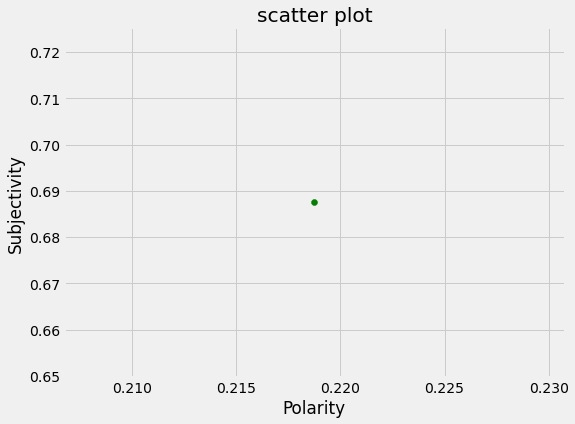

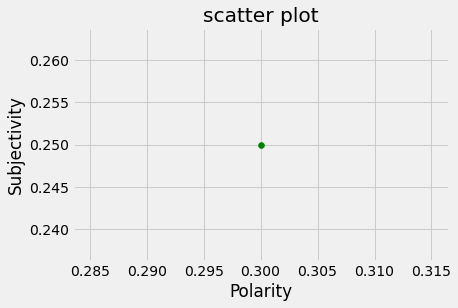

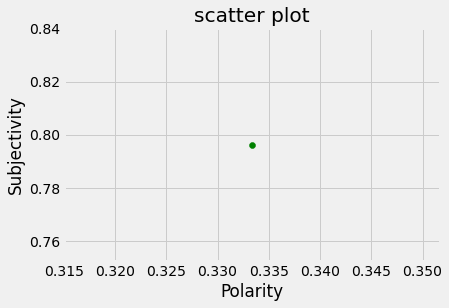

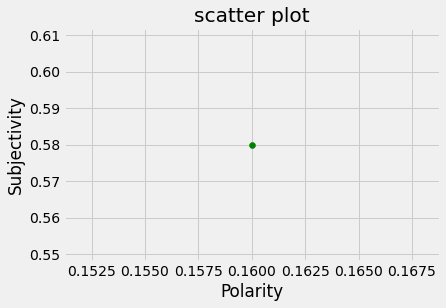

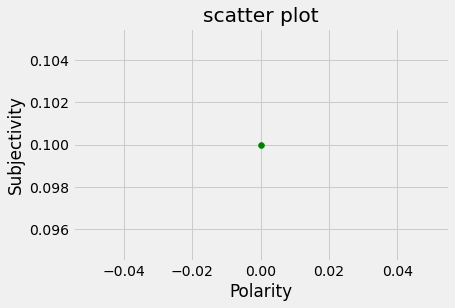

...

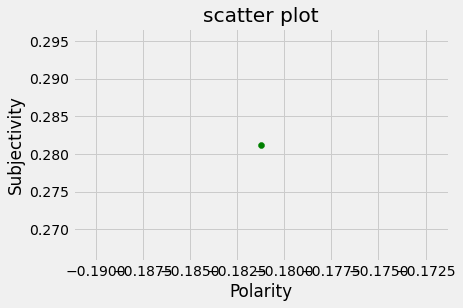

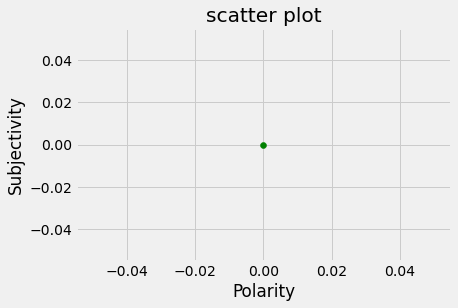

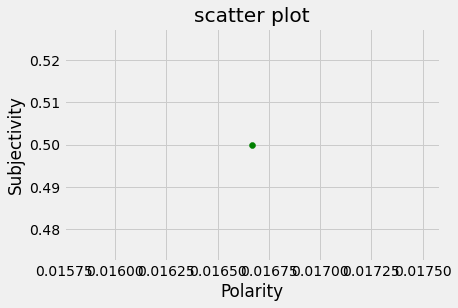

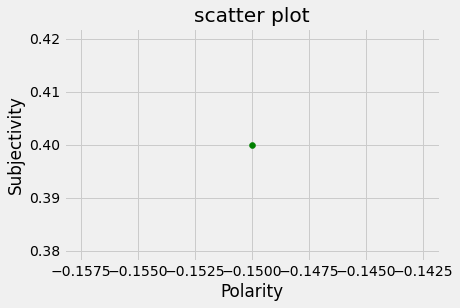

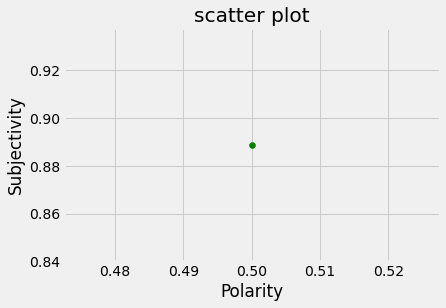

In [26]:
#create a scatter plot of the subjectivity and polarity
plt.figure(figsize=(8,6))
for i in range(0,len(df)):
    plt.scatter(df['Polarity'][i], df['Subjectivity'][i], color = 'green')
    plt.title('scatter plot')
    plt.xlabel('Polarity')
    plt.ylabel('Subjectivity')
    plt.show()

 #### 1= means subjective
    0= means objective
    anything greater than 0 is positive

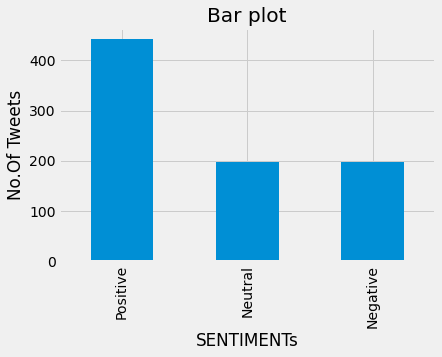

In [27]:
#create a bar chart
df['Sentiment'].value_counts().plot(kind='bar')
plt.title('Bar plot')
plt.xlabel('SENTIMENTs')
plt.ylabel('No.Of Tweets')
plt.show()

### Looking into tweets talking about 'Omicron'

In [32]:
# Tweets that has omicron mentioned in them
omicron_tweets = df[df['cleaned_tweets'].str.contains("covid-19|omicron")]
omicron_tweets.query("Sentiment=='Negative'")['cleaned_tweets'].tail(10)

665                                                  ...
670      Concerns have been raised that omicron break...
676      I had Pfizer and 1 booster and had covid(Omi...
684      Ummm… infection fatality rate is a measure o...
703     So I have had Covid two times! The first time...
714       ONS can probably give us a clue....They est...
718     in children has gone down because of infectio...
728      the point is for a horrifying moment they ha...
776                            omicron cured long pfizer
814     Its a killer he said about omicron  because h...
Name: cleaned_tweets, dtype: object

In [34]:
omicron_tweets.Sentiment.value_counts(normalize=True)

Positive    0.568966
Negative    0.270115
Neutral     0.160920
Name: Sentiment, dtype: float64

# Conclusion

##### closing thought
 * being furious!! while getting API keys there are tonnes of verification issues...!!! but finally got allof'em!!
 * As name suggest i've done this capstone with all my Senti and Mental Analysis!! XD

## Summary

* collecting all the data related to Omicrom/covid, making a dataframe by using Pandas function (*python library)
* Preprocessed the text_data(*why not?! It contains hashtags/@user_handle/special_characters/retweets/etc..):
    waittt...that's not enough!!:)), - REMOVE short words:
                                     - Tokenization("")
                                     - Stemming("").
* what NEXT- Time for EDA(*fun part!!-visualization):- creating wordcloud('visualizing the frequent words'):
                                                       creating the wordcloud for the negative and positive words TOOO!!
*    Now- creating sentiments = with the help of- TextBlob(*when a sentence is passed into it, it will give two outputs which are polarity and subjectivity):
    creating polarity and subjectivity['-1,1'].
*  plotting graphs based on sentiments- negative vs positive vs neutral!! 

* Model-Creating(ML):
  -split the data for trainning and testing
  - fitting Logistic regression(*because its a classification type problem).
     - done the hyperparameter tunning.
  - try another ML alogrithm SVC 'support vector machine'(used for both regression and classification):
     - again done the tunning with svc model.
 * wrap-up with model evaluation- as comapared to logistic regression the SVC perform slightly better (* means only 1%   better at leading).
 
 * that's all for the Twitter sentimental Analysis on omicron variant!!
     
##### Thanks if u have read all it!!:)) ##